# Structure-Properties Relationship (SPR) Analysis: Unveiling Molecular Interactions

In this notebook, we delve into Structure-Property Relationship (SPR) analysis to shed light into the intricate connections between molecular structures and their electronic properties.

In [23]:
# import RDKit
from rdkit import Chem
from rdkit.Chem import Draw
from rdkit.Chem import AllChem
from rdkit.Chem import DataStructs
from rdkit.Chem import rdFingerprintGenerator
# import pandasTools from rdkit
from rdkit.Chem import PandasTools

# import numpy and pandas
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt

# # improt dask
# import dask.dataframe as dd

# import plotly
import plotly.express as px
import plotly.graph_objects as go

# impot Path
from pathlib import Path

# imprt defaultdict
from collections import defaultdict

# show multiple outputs in one cell
from IPython.core.interactiveshell import InteractiveShell
# InteractiveShell.ast_node_interactivity = "all"
# InteractiveShell.ast_node_interactivity = "last_expr"


## Data Preprocessing

Before running the code below, make sure you have the necessary data files in the designated paths. If the pickle file containing preprocessed data doesn't exist, the following code will be executed to read the SDF and CSV files, perform necessary preprocessing steps, and save the data as a pickle file. If the pickle file already exists, the code will directly load the data from the pickle file.

After running the code, you can proceed with the analysis using the preprocessed data.


In [24]:
compas_2d_pkl = Path('.tempdata/compas-2D.pkl')
compas_2d_pkl.exists()

True

In [25]:
compas_2d_pkl = Path('.tempdata/compas-2D.pkl')

if not compas_2d_pkl.exists():
    # read .tempdata/compas-2D.sdf
    df = PandasTools.LoadSDF('.tempdata/compas-2D.sdf', smilesName='smi',molColName='mol',removeHs=False)
    df = df.query('charge == "0"')
    df = df.drop(columns=['energy'])
    # read csv file
    df2 = pd.read_csv('.tempdata/compas-2D.csv')
    # merge two dataframes
    df = df.merge(df2, on=['name', 'charge'])
    # save to .tempdata/compas-2D.pkl
    df.to_pickle('.tempdata/compas-2D.pkl')
else:
    df = pd.read_pickle('.tempdata/compas-2D.pkl')

# conver dipole columns from obj as numpy array float16
df['dipole'] = df['dipole'].apply(lambda x: np.array(x.replace('[' , '').replace(']' , '').split(', '), dtype=np.float16))
df['dipole_mag'] = df['dipole'].apply(lambda x: np.linalg.norm(x))

In [166]:
from pandas import DataFrame
from typing import Union

def calc_atomisation_energy(dataframe: DataFrame) -> Union[None, DataFrame]:
    """
    Calculate atomization energy based on element contributions.

    Parameters:
        dataframe : DataFrame
            The DataFrame containing element counts and energy values.

    Returns:
        None if 'energy' column is not present in the DataFrame, or the DataFrame with 'atomisation_energy' column added.
    """
    ELEMENT_ENERGIES = dict()
    ELEMENT_ELECTRONS = dict()
    au2kcal = 627.50957099203276

    ELEMENT_ENERGIES['B'] =  -24.611392160184
    ELEMENT_ENERGIES['C'] =  -37.791549361285
    ELEMENT_ENERGIES['H'] =   -0.497895503311
    ELEMENT_ENERGIES['N'] =  -54.516291260385
    ELEMENT_ENERGIES['O'] =  -74.977353881457
    ELEMENT_ENERGIES['S'] = -397.989272386771
    
    ELEMENT_ELECTRONS['B_ele'] = 5
    ELEMENT_ELECTRONS['C_ele'] = 6
    ELEMENT_ELECTRONS['H_ele'] = 1
    ELEMENT_ELECTRONS['N_ele'] = 7
    ELEMENT_ELECTRONS['O_ele'] = 8
    ELEMENT_ELECTRONS['S_ele'] = 16

    if 'energy' not in dataframe.columns:
        return None

    atomisation_energy = (
        (dataframe['h'] * ELEMENT_ENERGIES['H'] + dataframe['b'] * ELEMENT_ENERGIES['B'] +
         dataframe['c'] * ELEMENT_ENERGIES['C'] + dataframe['n'] * ELEMENT_ENERGIES['N'] +
         dataframe['o'] * ELEMENT_ENERGIES['O'] + dataframe['s'] * ELEMENT_ENERGIES['S']) 
         - dataframe['energy'] 
    ) * au2kcal

    dataframe['atomisation_energy'] = atomisation_energy

    return dataframe

df = calc_atomisation_energy(df)    

In [26]:
fpgen = rdFingerprintGenerator.GetMorganGenerator(fpSize=4096,
                                                radius=6,
                                                useBondTypes=False,
                                                includeRingMembership=True,
                                                # useHs=False
                                                    )

# calculate Morgan Fingerprint for each molecule 
%time fps = df['mol'].apply(lambda x: fpgen.GetFingerprint(x))
df['morgan'] = fps
# convert to numpy array
df['morgan_arr'] = [np.array(x) for x in df['morgan']]

CPU times: total: 8.56 s
Wall time: 24 s


# Dimentionality Reduction
Three dimentionalities reduction algorithms where used to represent the data into a 2D space. The algorithms used were PCA, t-SNE and UMAP. The parameters for t-SNE and UMAP were chosen based on a grid search for both methods resulting in the following parameters:
```
t-SNE: perplexity=30, n_iter=2000
UMAP: n_neighbors=40, min_dist=0.1, metric='jaccard'
```

### Calculating the reduced dimentions

In [27]:
# PCA and t-SNE of the Morgan Fingerprint
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap

# PCA
print("Calculating PCA...")
pca = PCA(n_components=100)
%time pca_result = pca.fit_transform(list(df['morgan_arr']))
df['pca-one'] = pca_result[:,0]
df['pca-two'] = pca_result[:,1]
df['pca-three'] = pca_result[:,2]

# t-SNE ETA ~ 5min 20s
print("Calculating t-SNE...")
tsne = TSNE(n_components=2, verbose=0, perplexity=30, n_iter=2000)
%time tsne_results = tsne.fit_transform(pca_result)
df['tsne-2d-one'] = tsne_results[:,0]
df['tsne-2d-two'] = tsne_results[:,1]

# umap # ETA 2 min
print("Calculating UMAP...")
reducer = umap.UMAP(n_neighbors=40, min_dist=0.1, metric='jaccard')
%time umap_result = reducer.fit_transform(list(df['morgan_arr']))
df['umap-one'] = umap_result[:,0]
df['umap-two'] = umap_result[:,1]

Calculating PCA...
CPU times: total: 22.8 s
Wall time: 6.68 s


In [182]:
from pandas import DataFrame
from typing import List, Optional, Tuple, Dict

def plot_grid_properties(data_frame: DataFrame, x: str, y: str, properties: List[str],
                         n_cols: int = 4, figsize: Tuple[int, int] = None, dpi: int = 150,
                         marker_size: int = 2, save_path: Optional[str] = None,
                         **kwargs,
                         ) -> Tuple[plt.Figure, np.ndarray]:
    """
    Create a grid of scatter plots for multiple properties against PCA components.

    Parameters:
    ----------
        data_frame : DataFrame
            The DataFrame containing the data.
        x : str
            The column name for the x-axis data.
        y : str
            The column name for the y-axis data.
        properties : List[str]
            A list of properties to be plotted.
        n_cols : int, optional
            The number of columns in the grid. Default is 4.
        figsize : Tuple[int, int], optional
            The size of the figure. Default is (4 * n_cols, 4 * n_rows).
        marker_size : int, optional
            The size of markers in the scatter plot. Default is 2.
        save_path : str, optional
            If provided, the path to save the image. Default is None (no saving).
        kwargs : dict, optional
            If provided aditional arguments to be passed to the seaborn scatterplot function.

    Returns:
    --------
        figure : plt.Figure
            The created matplotlib figure.
        axes : np.ndarray
            Array of axes in the grid. 

    Example:
    --------
    >>> plot_grid_properties(df, x='pca-one', y='pca-two', properties=props, n_cols = 4)
    ... fig, axes
    """
    n_rows = int(np.ceil(len(properties) / n_cols))
    if not figsize:
        figsize = (4 * n_cols, 4 * n_rows)
    figure, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=figsize, dpi=dpi)
    axes = axes.flatten()
    
    for i, prop in enumerate(properties):
        sns.scatterplot(data=data_frame, x=x, y=y, hue=prop, s=marker_size, ax=axes[i], **kwargs)
        axes[i].set_title(prop)
        axes[i].set_xlabel(x)
        axes[i].set_ylabel(y)
    
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path)
    
    return figure, axes

### Visualization of the reduced dimentions

#### Colored by electronic properties
The following code will plot the reduced dimentions for each of the dimentionality reduction algorithms. The different colors represent the different electronic properties of the molecules. 

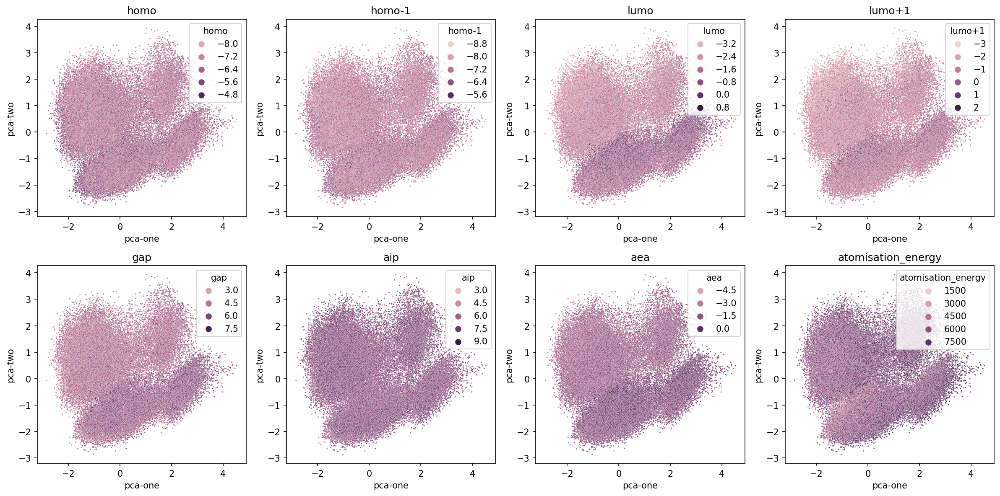

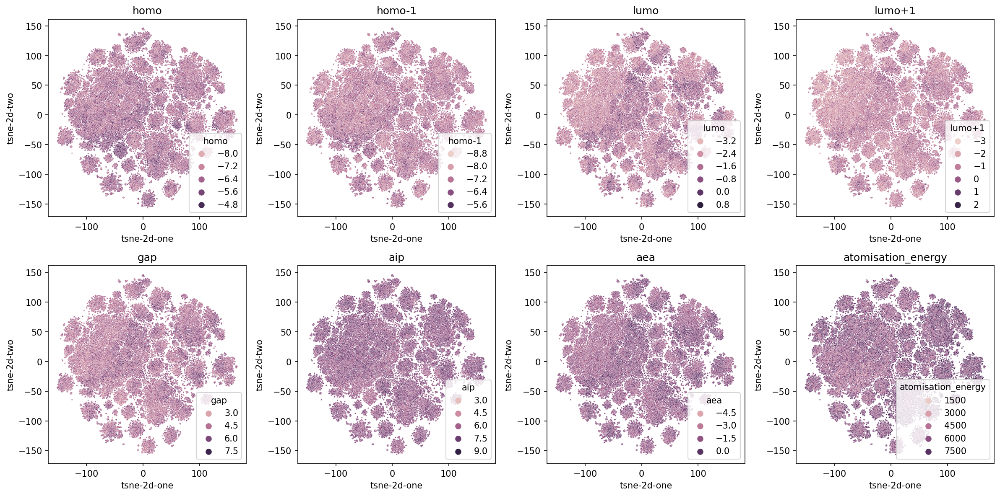

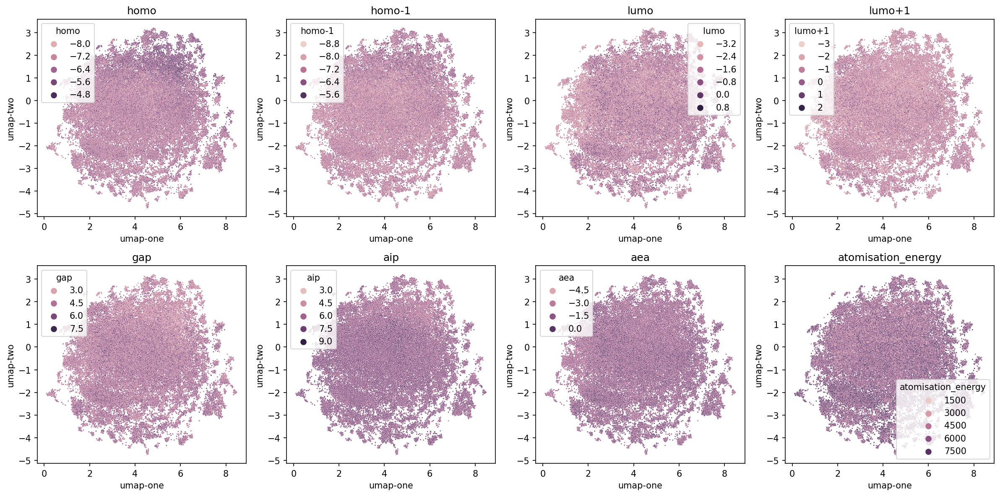

In [163]:
# ETA 2 min
props = ['homo','homo-1', 'lumo',  'lumo+1', 'gap',
         'aip', 'aea', 'atomisation_energy']
         
fig, axes = plot_grid_properties(df, x='pca-one', y='pca-two', properties=props, n_cols = 4)
fig, axes = plot_grid_properties(df, x='tsne-2d-one', y='tsne-2d-two', properties=props, n_cols = 4)
fig, axes = plot_grid_properties(df, x='umap-one', y='umap-two', properties=props, n_cols = 4)

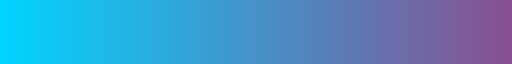

In [79]:
import matplotlib
colors = [
        [0, "#01D5FF"], # 
        # [0.5, "#A768A8"], # 
        [1, "#894F91"], # 
            ]
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", colors)
palette=cmap
palette


#### Colored by structural descriptors
The following code will plot the reduced dimentions for each of the dimentionality reduction algorithms. The different colors represent the different structural descriptors of the molecules.

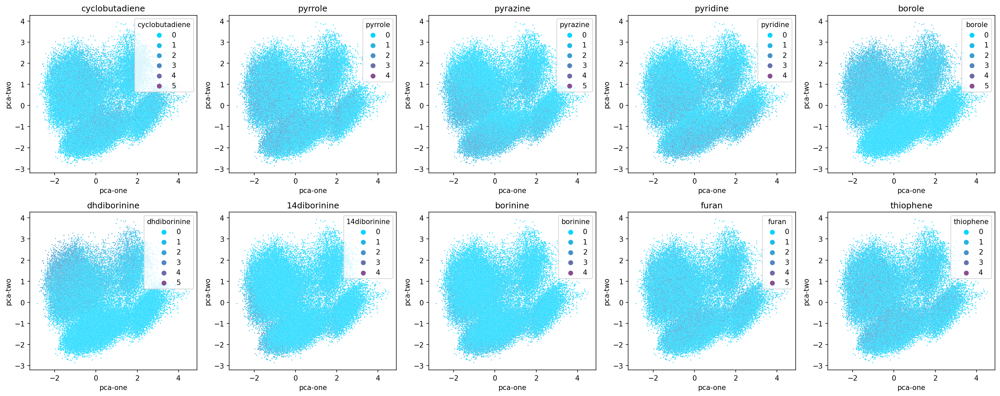

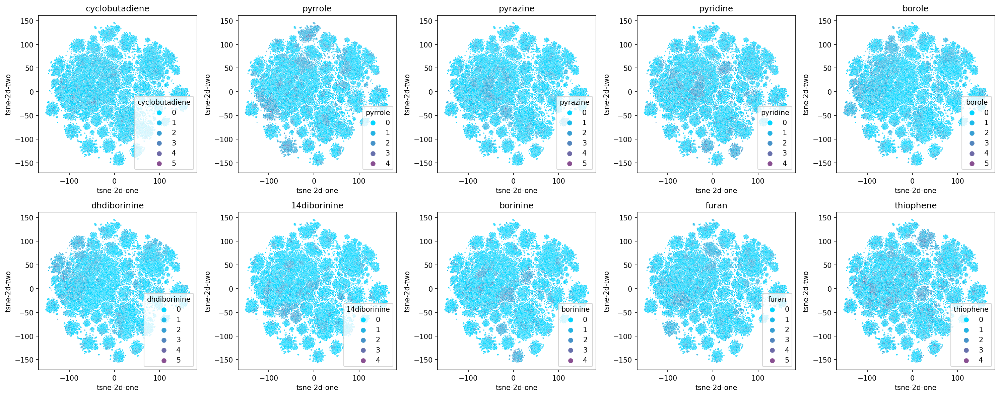

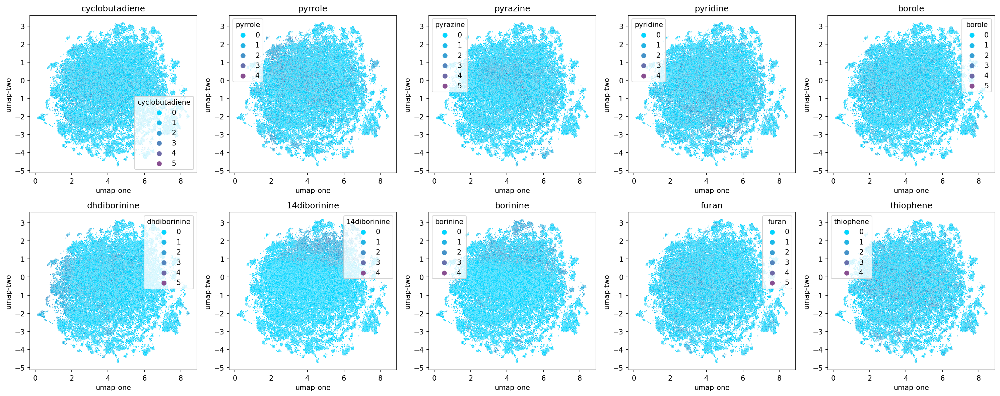

In [202]:
# ETA ~ 2 min
bblocks = ['cyclobutadiene',
           'pyrrole', 'pyrazine', 'pyridine',
           'borole', 'dhdiborinine', '14diborinine',  'borinine',
           'furan', 'thiophene',
           ]
fig, axes = plot_grid_properties(df, x='pca-one', y='pca-two', properties=bblocks, n_cols = 5, palette=cmap)
fig, axes = plot_grid_properties(df, x='tsne-2d-one', y='tsne-2d-two', properties=bblocks, n_cols = 5, palette=cmap)
fig, axes = plot_grid_properties(df, x='umap-one', y='umap-two', properties=bblocks, n_cols = 5, palette=cmap)

The section above shows the distribution of the molecules colored by a specific ring type. This highlights the area of the space where higher count of the ring type is more common. On the other hand, the section below shows the distribution of the molecules that only have a specific ring type. This highlights the area of the space where molecules with a specific ring type are located.

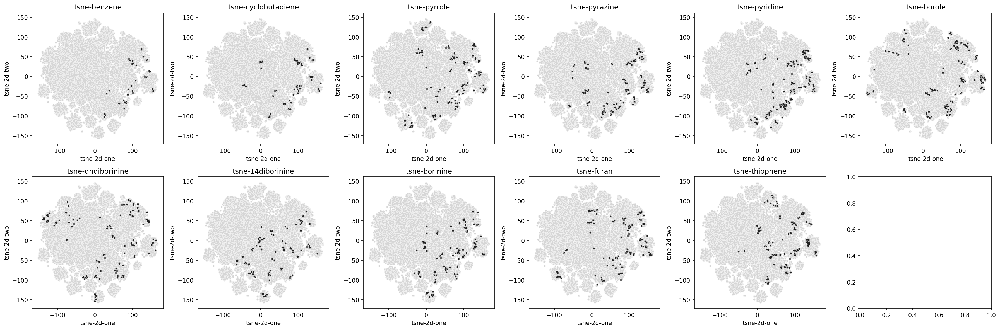

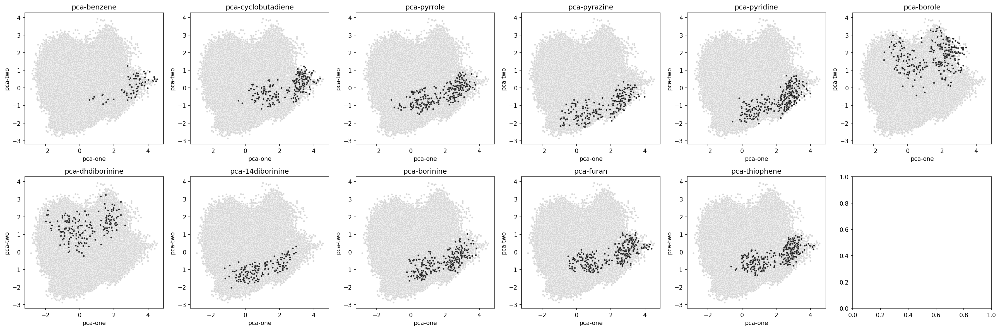

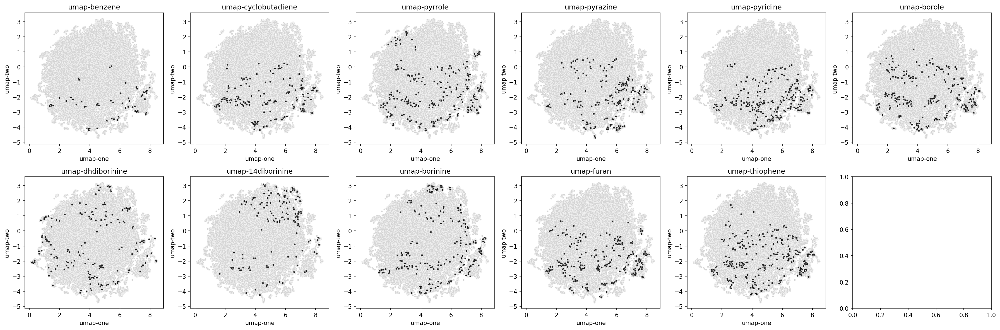

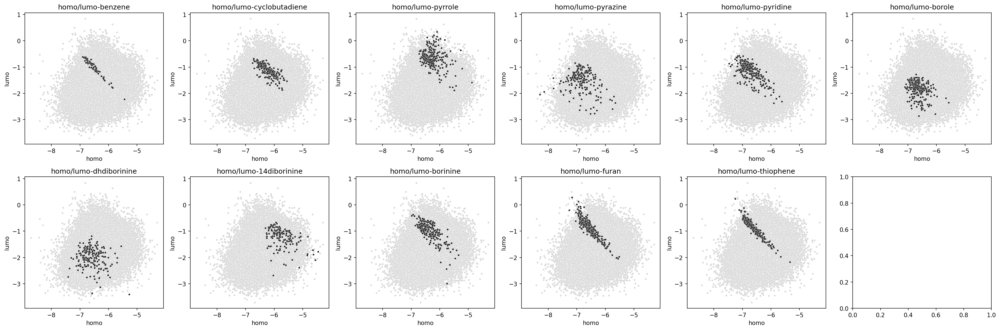

In [205]:
query = 'benzene != 0 & '
bblocks = ['benzene', 'cyclobutadiene',
           'pyrrole', 'pyrazine', 'pyridine',
           'borole', 'dhdiborinine', '14diborinine',  'borinine',
           'furan', 'thiophene',
           ]

def create_query(bblocks, target):
    query = 'benzene != 0 & '
    for bblock in bblocks:
        if bblock in target:
            query += f"`{bblock}` > 0 & "
        else:
            if bblock == 'benzene': continue
            query += f"`{bblock}` == 0 & "
    query = query[:-2]
    return query

# make a grid plot for each properties n_cols = 6, infer n_rows
n_cols = 6
n_rows = int(np.ceil(len(bblocks)/n_cols))
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(4 * n_cols, 4 * n_rows), dpi=150)
axes = axes.flatten()

for i, bblock in enumerate(bblocks):
    query = create_query(bblocks, bblock)
    data = df.query(query)
    sns.scatterplot(data=df, x='tsne-2d-one',  y='tsne-2d-two',s=10,  ax=axes[i],  color='#D6D6D6')
    sns.scatterplot(data=data, x='tsne-2d-one',  y='tsne-2d-two',s=10,  ax=axes[i], color='#212121')
    axes[i].set_title(f'tsne-{bblock}')
plt.tight_layout()

# make a grid plot for each properties n_cols = 6, infer n_rows
n_cols = 6
n_rows = int(np.ceil(len(bblocks)/n_cols))
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(4 * n_cols, 4 * n_rows), dpi=150)
axes = axes.flatten()

for i, bblock in enumerate(bblocks):
    query = create_query(bblocks, bblock)
    data = df.query(query)
    sns.scatterplot(data=df, x='pca-one',  y='pca-two',s=10,  ax=axes[i],  color='#D6D6D6')
    sns.scatterplot(data=data, x='pca-one',  y='pca-two',s=10,  ax=axes[i], color='#212121')
    axes[i].set_title(f'pca-{bblock}')
plt.tight_layout()

# make a grid plot for each properties n_cols = 6, infer n_rows
n_cols = 6
n_rows = int(np.ceil(len(bblocks)/n_cols))
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(4 * n_cols, 4 * n_rows), dpi=150)
axes = axes.flatten()

for i, bblock in enumerate(bblocks):
    query = create_query(bblocks, bblock)
    data = df.query(query)
    sns.scatterplot(data=df, x='umap-one',  y='umap-two',s=10, ax=axes[i], color='#D6D6D6')
    sns.scatterplot(data=data, x='umap-one',  y='umap-two',s=10,  ax=axes[i], color='#212121')
    axes[i].set_title(f'umap-{bblock}')
plt.tight_layout()

# make a grid plot for each properties n_cols = 6, infer n_rows
n_cols = 6
n_rows = int(np.ceil(len(bblocks)/n_cols))
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(4 * n_cols, 4 * n_rows), dpi=150)
axes = axes.flatten()

for i, bblock in enumerate(bblocks):
    query = create_query(bblocks, bblock)
    data = df.query(query)
    sns.scatterplot(data=df, x='homo',  y='lumo',s=10, ax=axes[i], color='#D6D6D6')
    sns.scatterplot(data=data, x='homo',  y='lumo',s=10,  ax=axes[i], color='#212121')
    axes[i].set_title(f'homo/lumo-{bblock}')
plt.tight_layout()


# HOMO-LUMO space
Dimensionality reduction techniques offer valuable tools for transforming high-dimensional spaces into lower dimensions, serving purposes such as data compression, accelerated calculations, and improved performance. As our primary interest lies in two-dimensional representations, the preceding section focused on reducing the dimensionality of the COMPAS-2D dataset's molecular chemical space using the ECFP6 fingerprint. In this section, we utilize the HOMO and LUMO energies to create a two-dimensional coordinate system for representing molecules.

#### Color-Coded by Electronic Properties
The code snippet provided below will generate a plot in the HOMO/LUMO space, with each molecule depicted based on its HOMO and LUMO energies. Diverse colors are employed to indicate the distinct electronic properties of the molecules.

In [176]:
df.columns

Index(['name', 'charge', 'ID', 'smi', 'mol', 'formula', 'inchi', 'smiles',
       'rings', 'aromatic_rings', 'atoms', 'heteroatoms', 'heterocycles',
       'branch', 'cyclobutadiene', 'pyrrole', 'borole', 'furan', 'thiophene',
       'dhdiborinine', '14diborinine', 'pyrazine', 'pyridine', 'borinine',
       'benzene', 'h', 'c', 'b', 's', 'o', 'n', 'homo', 'lumo', 'homo-1',
       'lumo+1', 'gap', 'dispersion', 'energy', 'aip', 'aea', 'dipole', 'rmsd',
       'dipole_mag', 'morgan', 'morgan_arr', 'pca-one', 'pca-two', 'pca-three',
       'tsne-2d-one', 'tsne-2d-two', 'umap-one', 'umap-two',
       'atomisation_energy'],
      dtype='object')

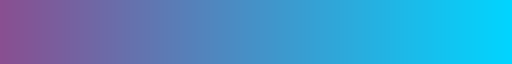

In [178]:
cmap.reversed()

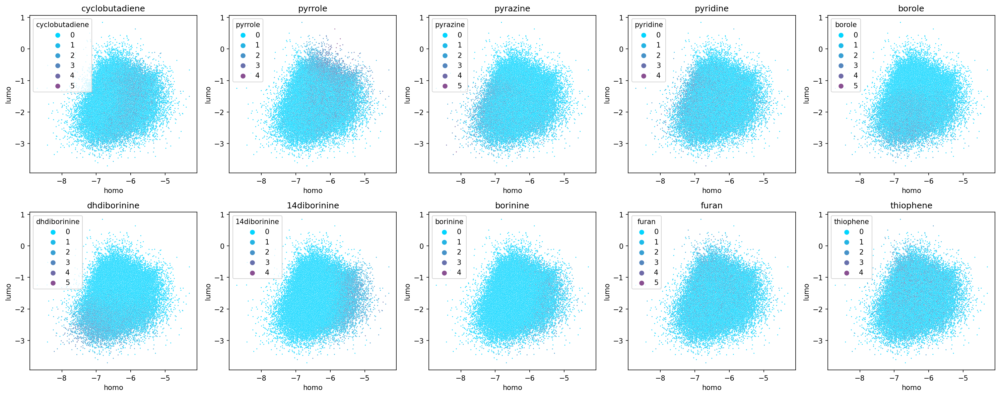

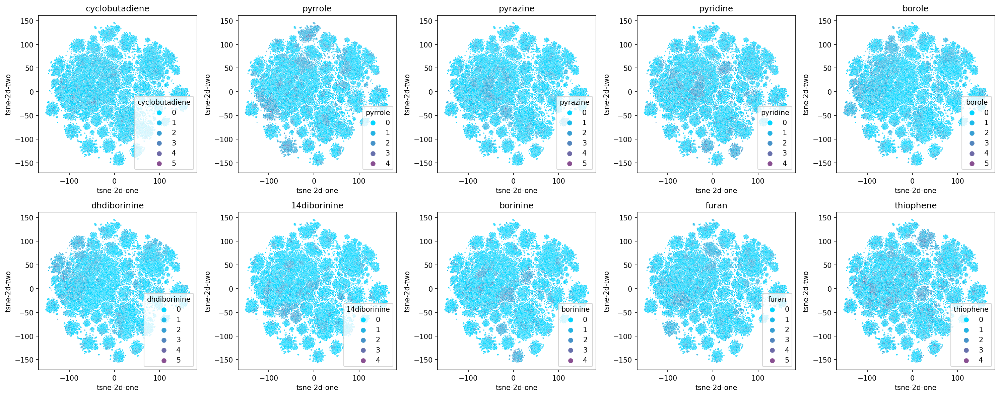

In [184]:
props = ['homo','homo-1', 'lumo',  'lumo+1', 'gap',
         'aip', 'aea', 'atomisation_energy']
         
bblocks = ['cyclobutadiene',
           'pyrrole', 'pyrazine', 'pyridine',
           'borole', 'dhdiborinine', '14diborinine',  'borinine',
           'furan', 'thiophene',
           ]        
fig, axes = plot_grid_properties(df, x='homo', y='lumo', properties=bblocks, n_cols = 5, palette=cmap)
fig, axes = plot_grid_properties(df, x='tsne-2d-one', y='tsne-2d-two', properties=bblocks, n_cols = 5, palette=cmap)

In [192]:
def mask_data_frame(data_frame: DataFrame, query: str, mask_col: str = 'mask') -> DataFrame:
    """
    Mask rows in a DataFrame based on a query.

    Parameters:
    ----------
        data_frame (DataFrame): The DataFrame to be masked.
        query (str): The query string.
        mask_col (str, optional): The column for storing the mask. Default is 'mask'.

    Returns:
    --------
        DataFrame: The masked DataFrame.
    """
    data_frame[mask_col] = False
    data_frame.loc[data_frame.query(query).index, mask_col] = True
    return data_frame

14077    True
14129    True
14217    True
14361    True
14378    True
         ... 
51818    True
51974    True
51979    True
51984    True
51997    True
Name: show, Length: 310, dtype: bool